# Atomic Analysis with graph theory, K-Means, and PCA
### Notebook by Austin Houston
### UTK, Spring 2025
### ML Summer School

[![OpenInColab](https://colab.research.google.com/assets/colab-badge.svg)](
    https://colab.research.google.com/github/gduscher/MLSTEM2025/blob/main/Day%201/5_Atomic_analysis.ipynb)

In [ ]:
import sys
import importlib.metadata
def test_package(package_name):
    """Test if package exists and returns version or -1"""
    try:
        version = importlib.metadata.version(package_name)
    except importlib.metadata.PackageNotFoundError:
        version = '-1'
    return version

if test_package('pyTEMlib') < '0.2025.4.0':
    print('installing pyTEMlib')
    !{sys.executable} -m pip install  --upgrade pyTEMlib -q
print('done')

In [4]:
# necessities
import os
import sys
import numpy as np

# pyTEMlib
import pyTEMlib
import pyTEMlib.file_tools as ft
import pyTEMlib.image_tools as it
from pyTEMlib.atom_tools import atom_refine

# sci-kit
from skimage.feature import blob_log
from scipy.spatial import KDTree, cKDTree
from scipy.spatial import Delaunay, Voronoi, ConvexHull, voronoi_plot_2d
from scipy.spatial.distance import cdist

# -- stars of the show --
from sklearn.cluster import DBSCAN, KMeans
from sklearn.decomposition import PCA

# grapth theory stuff
from collections import defaultdict, deque

# plotting
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.colors as colors
import matplotlib.patches as patches
from shapely.geometry import Point, Polygon
# %matplotlib ipympl
# %matplotlib widget
if 'google.colab' in sys.modules:
    from  google.colab import drive 
    from google.colab import output
    output.enable_custom_widget_manager()



You don't have igor2 installed.     If you wish to open igor files, you will need to install it     (pip install igor2) before attempting.
You don't have gwyfile installed.     If you wish to open .gwy files, you will need to      install it (pip install gwyfile) before attempting.
Symmetry functions of spglib enabled


### Open Data

In [ ]:
if 'google.colab' in sys.modules:
    drive.mount("/content/drive")
    if not os.path.exists('./haadf_VMoWS2.emd'):
        !wget  https://github.com/gduscher/MLSTEM2025/example_data/haadf_VMoWS2.emd

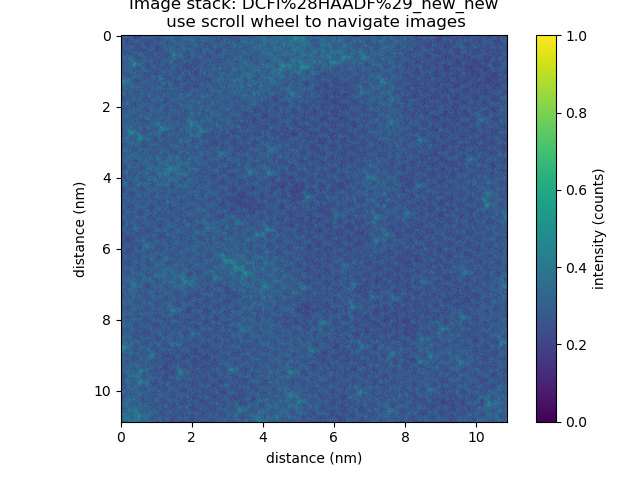

In [13]:
dset = ft.open_file('./haadf_VMoWS2.emd')

image = dset['Channel_000']
image -= image.min()
image /= image.max()

view = image.plot()

### Drift Correction

In [15]:
rig_reg = it.rigid_registration(image)
dem_reg = it.demon_registration(rig_reg)

avg_im = dem_reg.sum(axis=0)
avg_im.data_type = 'IMAGE'
avg_im -= avg_im.min()
avg_im /= avg_im.max()

Stack contains  20  images, each with 1024  pixels in x-direction and  1024  pixels in y-direction


  0%|          | 0/20 [00:00<?, ?it/s]

  0%|          | 0/20 [00:00<?, ?it/s]

:-)
You have successfully completed Diffeomorphic Demons Registration


### Blob Finding and Refine

In [16]:
def make_gauss(size_x, size_y, width=1.0, x0=0.0, y0=0.0, intensity=1.0):
    """Make a Gaussian shaped probe """
    size_x = size_x / 2
    size_y = size_y / 2
    x, y = np.mgrid[-size_x:size_x, -size_y:size_y]
    g = np.exp(-((x - x0) ** 2 + (y - y0) ** 2) / 2.0 / width ** 2)
    probe = g / g.sum() * intensity
    return probe

  0%|          | 0/500 [00:00<?, ?it/s]

converged in 11 iterations

 Lucy-Richardson deconvolution converged in 11  iterations


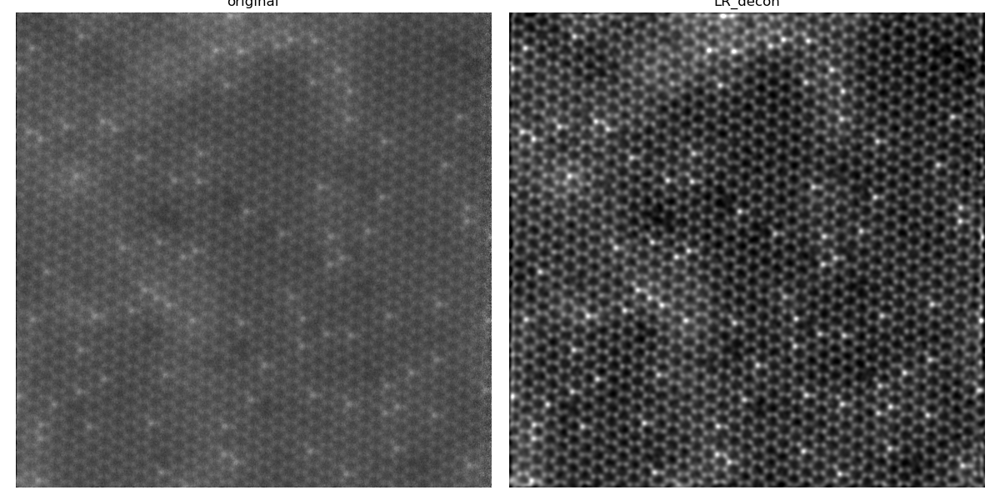

In [17]:
# ------- Input ------
atoms_size = 0.05
# --------------------
scale = avg_im.x.values[1]

avg_im.metadata['experiment']= {'convergence_angle': 30, 'acceleration_voltage': 60000.}
gauss_diameter = atoms_size/scale
gauss_probe = make_gauss(avg_im.shape[0], avg_im.shape[1], gauss_diameter)
lr_dataset = it.decon_lr(avg_im, gauss_probe, verbose=False)

fig, ax = plt.subplots(1,2, figsize=(12, 6), sharex=True, sharey=True)
ax[0].imshow(avg_im.T, cmap='grey')
ax[0].set_title('original')
ax[1].imshow(lr_dataset.T, cmap='grey',vmin=0.2,vmax=0.7)
ax[1].set_title('LR_decon')
for a in ax:
    a.axis('off')
fig.tight_layout()


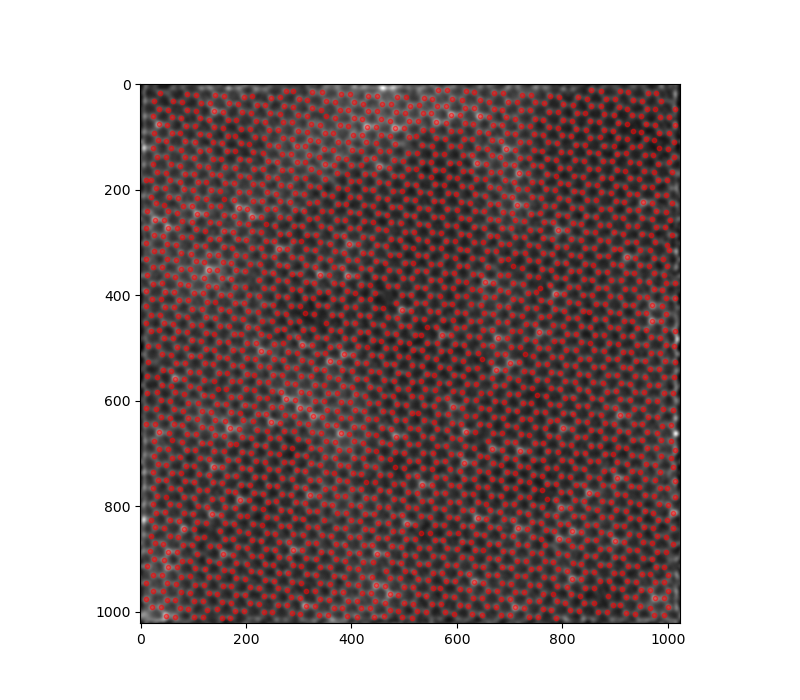

In [18]:
# ------- Input ------
threshold = 0.01 #usally between 0.01 and 0.9  the smaller the more atoms
# ----------------------

blobs = blob_log(lr_dataset, max_sigma=8, threshold=threshold)

blobs = pyTEMlib.graph_tools.delete_rim_atoms(blobs, lr_dataset.shape, 10)

fig, ax = plt.subplots(1, 1,figsize=(8,7), sharex=True, sharey=True)
ax.imshow(lr_dataset.T, cmap='gray')
ax.scatter(blobs[:, 0], blobs[:, 1], c='r', s=10, alpha = .5)

using radius  6 pixels


  0%|          | 0/2527 [00:00<?, ?it/s]

/Users/austin/miniconda3/envs/pytemlib_2025/lib/python3.11/site-packages/pyTEMlib/probe_tools.py:17: RuntimeWarning: invalid value encountered in divide
  probe = g / g.sum() * intensity


Text(0.5, 1.0, 'refined atom postion')

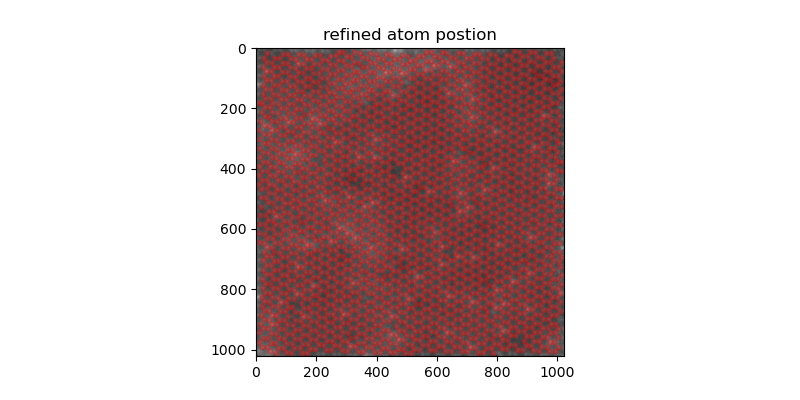

In [19]:
# ------- Input ------
atom_radius = 6  # in pixel

sym = atom_refine(np.array(avg_im), blobs, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
refined_atoms = np.array(sym['atoms'])

intensity = np.array(sym['intensity_area'])
pos = np.array(sym['atoms'])

# remove atoms and intensities where intensiy < 0
pos = pos[intensity > 0]
intensity = intensity[intensity > 0]

fig, ax = plt.subplots(1, 1, figsize=(8, 4), sharex=True, sharey=True)
ax.imshow(avg_im.T, cmap = 'gray')
ax.scatter(pos[:,0],pos[:,1],  s=10, alpha = 0.3, color = 'red')
ax.set_title('refined atom postion')


### Lattice vectors and graph theory

In [20]:
# Get lattice params
tree = KDTree(pos)
distances, indices = tree.query(pos, k=13) 
neighbor_ids = indices[:, 1:]

nn_vectors = []
for i in range(len(pos)):
    blob = pos[i]
    neighbors = pos[neighbor_ids[i]]
    vectors = neighbors - blob 
    nn_vectors.append(vectors)
nn_vectors = np.array(nn_vectors)[:,:6,:]

angles = np.arctan2(nn_vectors[:, :, 1], nn_vectors[:, :, 0])
sorted_indices = np.argsort(angles, axis=1)  # indices to sort angles for each atom
nn_vectors_sorted = np.take_along_axis(nn_vectors, sorted_indices[:, :, None], axis=1)
avg_nn_vectors = nn_vectors_sorted.mean(axis=0)

num_clusters = 12
reshaped_nn_vectors = nn_vectors.reshape(-1, 2)
kmeans = KMeans(n_clusters=num_clusters, random_state=0)
kmeans.fit(reshaped_nn_vectors)
cluster_labels = kmeans.labels_.reshape(nn_vectors.shape[:2])
cluster_centers = kmeans.cluster_centers_

# sort cluster centers into two groups.  closest and furthest away
lengths = np.linalg.norm(cluster_centers, axis=1)
mean_length = np.mean(lengths)
v_nn1 = cluster_centers[lengths<mean_length]
v_nn2 = cluster_centers[lengths>mean_length]


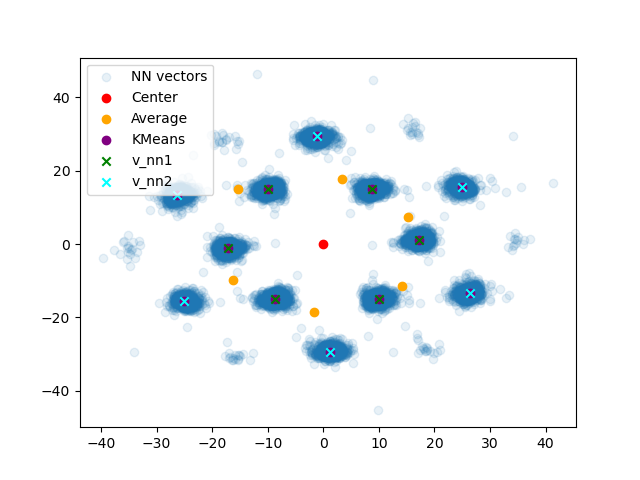

In [21]:
plt.figure()
plt.scatter(nn_vectors[:, :, 0], nn_vectors[:, :, 1], alpha=0.1, label='NN vectors')
plt.scatter(0, 0, c='r', label='Center')
plt.scatter(avg_nn_vectors[:, 0], avg_nn_vectors[:, 1], c='orange', label='Average')
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='purple', label='KMeans')

plt.scatter(v_nn1[:, 0], v_nn1[:, 1], c='green', label='v_nn1', marker = 'x')
plt.scatter(v_nn2[:, 0], v_nn2[:, 1], c='cyan', label='v_nn2', marker = 'x')
plt.legend()

In [22]:
def graph_filter(blobs, nn_vectors, start_node, tolerance, edge_margin):
    # Breadth First Search
    tree = cKDTree(blobs)

    visited = set([start_node])
    queue = deque([start_node])
    empty_positions = []

    while queue:
        current = queue.popleft()
        current_point = blobs[current]

        for offset in nn_vectors:
            expected_pos = current_point + offset
            dist, idx = tree.query(expected_pos)
            
            if dist > tolerance:
                empty_positions.append(expected_pos)  # store missing positions
            elif dist <= tolerance and idx not in visited:
                visited.add(idx)
                queue.append(idx)
    visited = np.array(list(visited))

    # edge filtering
    x_min, y_min = blobs.min(axis=0) + edge_margin
    x_max, y_max = blobs.max(axis=0) - edge_margin

    in_bounds = (
        (blobs[visited, 0] > x_min) & (blobs[visited, 0] < x_max) &
        (blobs[visited, 1] > y_min) & (blobs[visited, 1] < y_max)
    )
    final_nodes = visited[in_bounds]

    return blobs[final_nodes]

In [23]:
# filter with graph theory
metal_atoms = graph_filter(pos, nn_vectors = v_nn2, start_node = 100, tolerance = 5, edge_margin = 0)
sulfur_atoms = graph_filter(pos, nn_vectors = v_nn2, start_node = 99, tolerance = 5, edge_margin = 0)

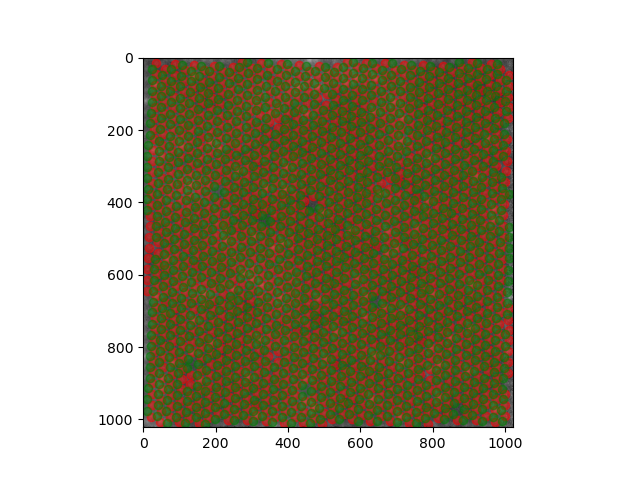

In [25]:
plt.figure()
plt.imshow(avg_im.T, cmap='grey')
plt.scatter(metal_atoms[:,0], metal_atoms[:,1], c='r', alpha=0.5)
plt.scatter(sulfur_atoms[:,0], sulfur_atoms[:,1], c='g', alpha=0.5)

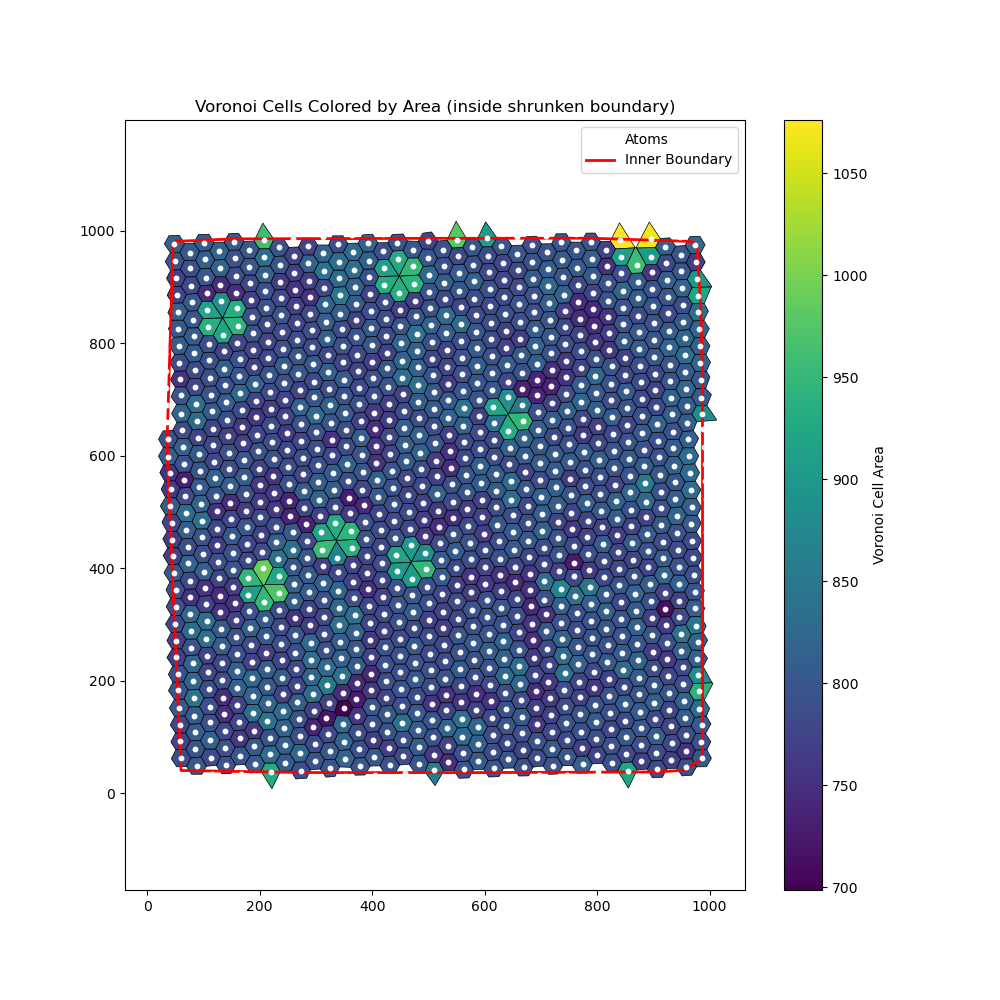

In [26]:
vor = Voronoi(metal_atoms)
hull = ConvexHull(metal_atoms)
hull_polygon = Polygon(metal_atoms[hull.vertices])

shrink_distance = 25
inner_polygon = hull_polygon.buffer(-shrink_distance)

def voronoi_cell_area(vertices):
    return 0.5 * np.abs(np.dot(vertices[:,0], np.roll(vertices[:,1],1)) - np.dot(vertices[:,1], np.roll(vertices[:,0],1)))

areas = []
centroids = []
polygons = []
for i, region_idx in enumerate(vor.point_region):
    region = vor.regions[region_idx]
    if -1 in region or len(region) == 0:
        continue  # skip infinite/empty regions
    vertices = vor.vertices[region]
    centroid = np.mean(vertices, axis=0)
    if not inner_polygon.contains(Point(centroid)):
        continue  # skip centroids outside shrunk polygon
    area = voronoi_cell_area(vertices)
    areas.append(area)
    centroids.append(centroid)
    polygons.append(vertices)
areas = np.array(areas)
centroids = np.array(centroids)

norm = colors.Normalize(vmin=areas.min(), vmax=areas.max())
cmap = cm.viridis

fig, ax = plt.subplots(figsize=(10,10))
for poly, area in zip(polygons, areas):
    color = cmap(norm(area))
    ax.fill(*poly.T, color=color, edgecolor='k', linewidth=0.5)
ax.scatter(*metal_atoms.T, color='white', s=10, zorder=5, label='Atoms')

x_inner, y_inner = inner_polygon.exterior.xy
ax.plot(x_inner, y_inner, 'r-', lw=2, label='Inner Boundary')
sm = cm.ScalarMappable(norm=norm, cmap=cmap)
cbar = fig.colorbar(sm, ax=ax, label='Voronoi Cell Area')
ax.axis('equal')
ax.legend()
ax.set_title('Voronoi Cells Colored by Area (inside shrunken boundary)')
plt.show()

In [27]:
# Get Voronoi vertices inside inner boundary
candidate_points = []
for v in vor.vertices:
    p = Point(v)
    if inner_polygon.contains(p):
        candidate_points.append(v)
candidate_points = np.array(candidate_points)

print(f"Number of candidate points: {len(candidate_points)}")

# DBSCAN clustering
eps = np.linalg.norm(v_nn2[0]) /2 # you may adjust
min_samples = 3

db = DBSCAN(eps=eps, min_samples=min_samples).fit(candidate_points)
labels = db.labels_

unique_labels = set(labels)
print(f"Number of clusters found: {len(unique_labels) - (1 if -1 in unique_labels else 0)}")

# Compute cluster centers
cluster_centers = []
for lbl in unique_labels:
    if lbl == -1:
        continue  # skip noise
    cluster_pts = candidate_points[labels == lbl]
    center = np.mean(cluster_pts, axis=0)
    cluster_centers.append(center)
cluster_centers = np.array(cluster_centers)

Number of candidate points: 2238
Number of clusters found: 7


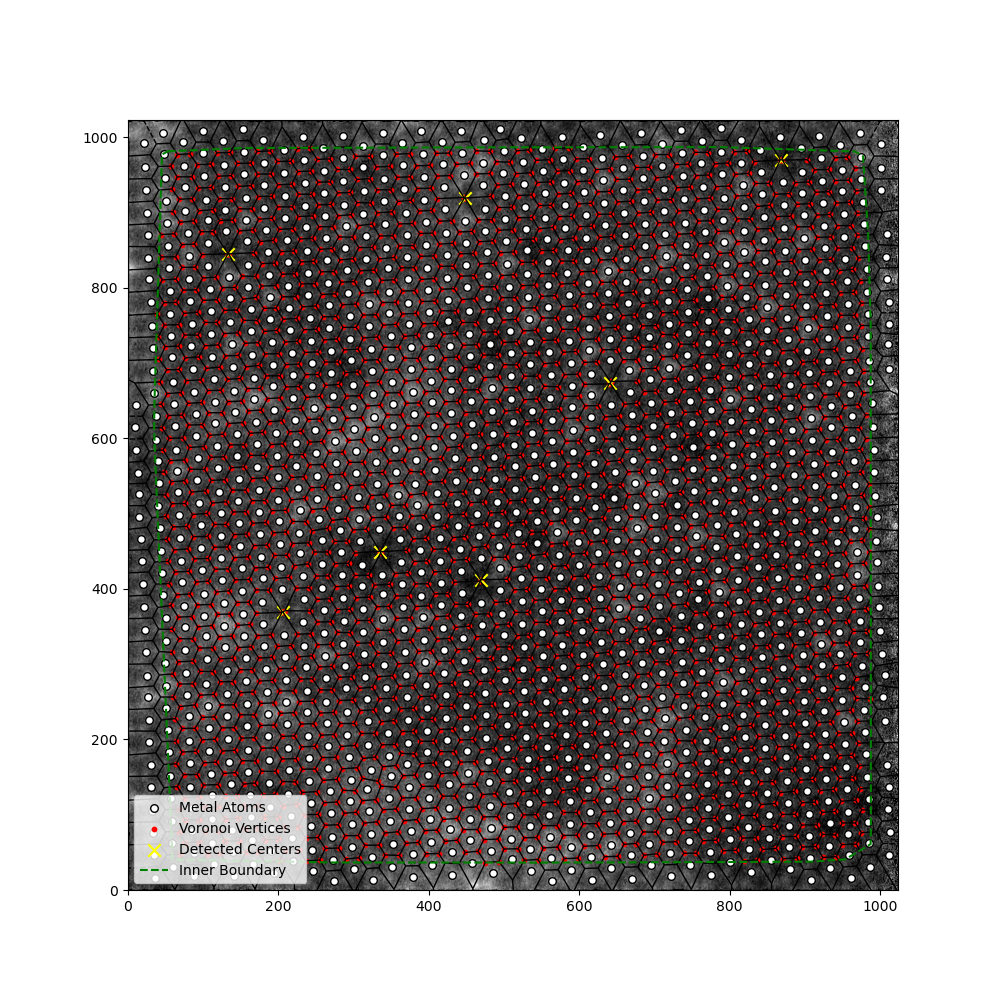

In [28]:
fig, ax = plt.subplots(figsize=(10, 10))

ax.imshow(avg_im.T, cmap='grey',vmin=0.2,vmax=0.7)
voronoi_plot_2d(vor, ax=ax, show_vertices=False, show_points=False)

ax.scatter(metal_atoms[:, 0], metal_atoms[:, 1], color='white', edgecolor='black', s=30, label='Metal Atoms')
ax.scatter(candidate_points[:, 0], candidate_points[:, 1], color='red', s=10, label='Voronoi Vertices')
ax.scatter(cluster_centers[:, 0], cluster_centers[:, 1], color='yellow', s=80, marker='x', label='Detected Centers')

# boundary
x_inner, y_inner = inner_polygon.exterior.xy
ax.plot(x_inner, y_inner, color='green', linestyle='--', label='Inner Boundary')

ax.set_xlim(0, avg_im.shape[0])
ax.set_ylim(0, avg_im.shape[0])
ax.set_aspect('equal')
ax.legend()
plt.show()

In [29]:
# add the detected centers to the metal atoms
metal_atoms_final = np.concatenate([metal_atoms,cluster_centers])

(-0.5, 1022.5, 1021.5, -0.5)

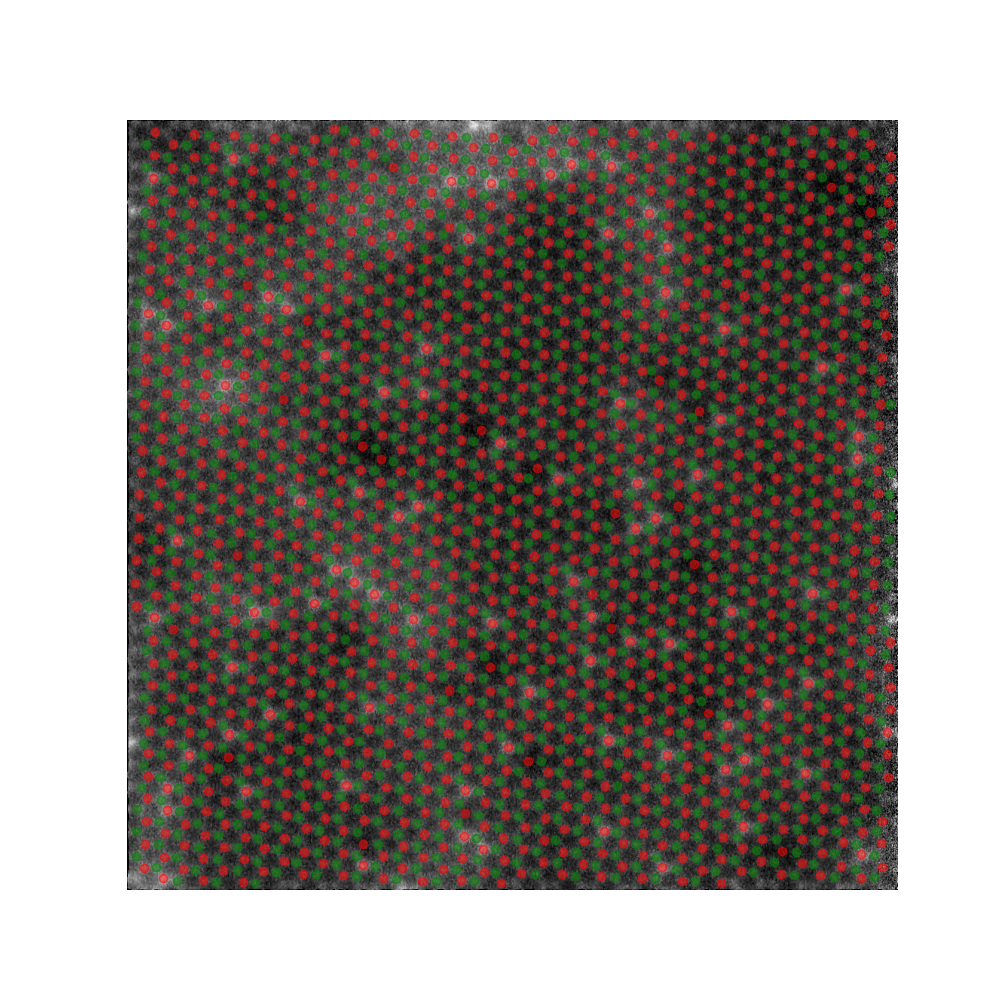

In [30]:
plt.figure(figsize = (10,10))
plt.imshow(avg_im.T, cmap='grey',vmin=0.2,vmax=0.7)
plt.scatter(metal_atoms_final[:,0], metal_atoms_final[:,1], c='r', alpha=0.5)
plt.scatter(sulfur_atoms[:,0], sulfur_atoms[:,1], c='g', alpha=0.5)

plt.axis('off')

### Classify atoms by intensity

In [31]:
atom_radius = 6  # in pixel

metal_sym = atom_refine(np.array(avg_im), metal_atoms_final, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
metal_pos = np.array(metal_sym['atoms'])
metal_int = np.array(metal_sym['intensity_area'])


sulfur_sym = atom_refine(np.array(avg_im), sulfur_atoms, atom_radius, max_int = 0, min_int = 0, max_dist = 2)
sulfur_pos = np.array(sulfur_sym['atoms'])
sulfur_int = np.array(sulfur_sym['intensity_area'])


# normalize each metal intensity to the local sulfur intensity
sulfur_tree = cKDTree(sulfur_pos)
distances, indices = sulfur_tree.query(metal_pos, k=3)
nearest_sulfur_ints = sulfur_int[indices]  # shape (N,3)
mean_sulfur_int = np.mean(nearest_sulfur_ints, axis=1)  # shape (N,)
metal_int_norm = metal_int / mean_sulfur_int

using radius  6 pixels


  0%|          | 0/1269 [00:00<?, ?it/s]

/Users/austin/miniconda3/envs/pytemlib_2025/lib/python3.11/site-packages/pyTEMlib/probe_tools.py:17: RuntimeWarning: invalid value encountered in divide
  probe = g / g.sum() * intensity


using radius  6 pixels


  0%|          | 0/1259 [00:00<?, ?it/s]

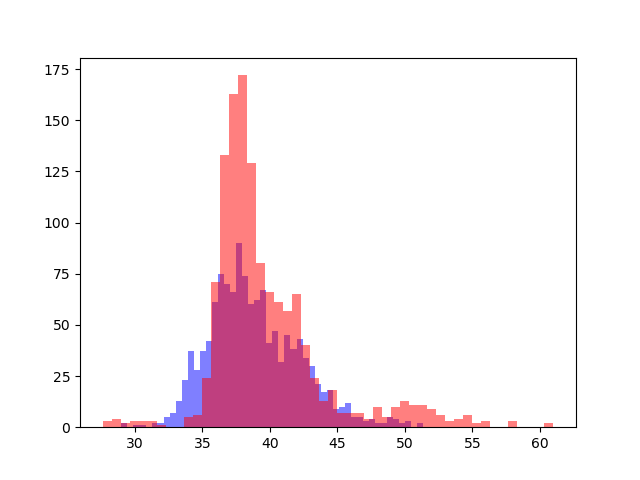

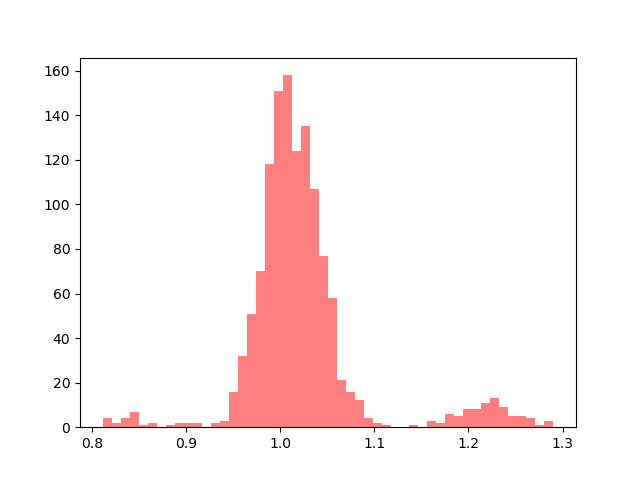

In [32]:
plt.figure()

plt.hist(sulfur_int, bins=50, color='blue', alpha=0.5);
plt.hist(metal_int, bins=50, color='red', alpha=0.5);

plt.figure()
plt.hist(metal_int_norm, bins=50, color='red', alpha=0.5);

In [49]:
cutoffs = [0.93,1.11]

# V, Mo, W
V_filter = np.where(metal_int_norm < cutoffs[0])
Mo_filter = np.where((metal_int_norm >= cutoffs[0]) & (metal_int_norm <= cutoffs[1]))
W_filter = np.where(metal_int_norm > cutoffs[1])

V_pos = metal_pos[V_filter]
V_int = metal_int_norm[V_filter]

Mo_pos = metal_pos[Mo_filter]
Mo_int = metal_int_norm[Mo_filter]

W_pos = metal_pos[W_filter]
W_int = metal_int_norm[W_filter]


total = len(V_int) + len(W_int) + len(Mo_int)

print('relative composition:')
print(f'W: {np.round(100*len(W_int)/total,2)} %')
print(f'V: {np.round(100*len(V_int)/total,2)} %')
print(f'Mo: {np.round(100*len(Mo_int)/total,2)} %')



relative composition:
W: 6.7 %
V: 2.13 %
Mo: 91.17 %


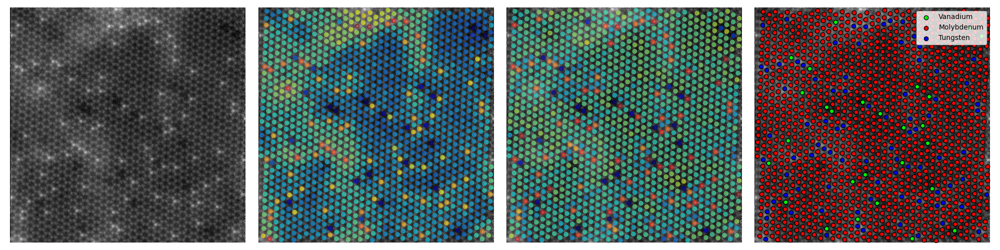

In [50]:
fig, ax = plt.subplots(1,4,figsize = (20,5), sharex=True, sharey=True)
colors = ['#FF0000', '#00FF00', '#0000FF'] 
for a in ax:
    a.imshow(avg_im.T, cmap='grey',vmin=0.2,vmax=0.7)
    a.axis('off')

ax[1].scatter(metal_pos[:,0], metal_pos[:,1], c=metal_int, cmap='jet', alpha=0.5)
ax[2].scatter(metal_pos[:,0], metal_pos[:,1], c=metal_int_norm, cmap='jet', alpha=0.5)

ax[3].scatter(V_pos[:,0], V_pos[:,1], alpha=1, c=colors[1], edgecolors='k', label = 'Vanadium')
ax[3].scatter(Mo_pos[:,0], Mo_pos[:,1], alpha=1, c=colors[0], edgecolors='k', label = 'Molybdenum')
ax[3].scatter(W_pos[:,0], W_pos[:,1], alpha=1, c=colors[2], edgecolors='k', label = 'Tungsten')
ax[3].legend(loc='upper right')

fig.tight_layout()


### Compute PDFs

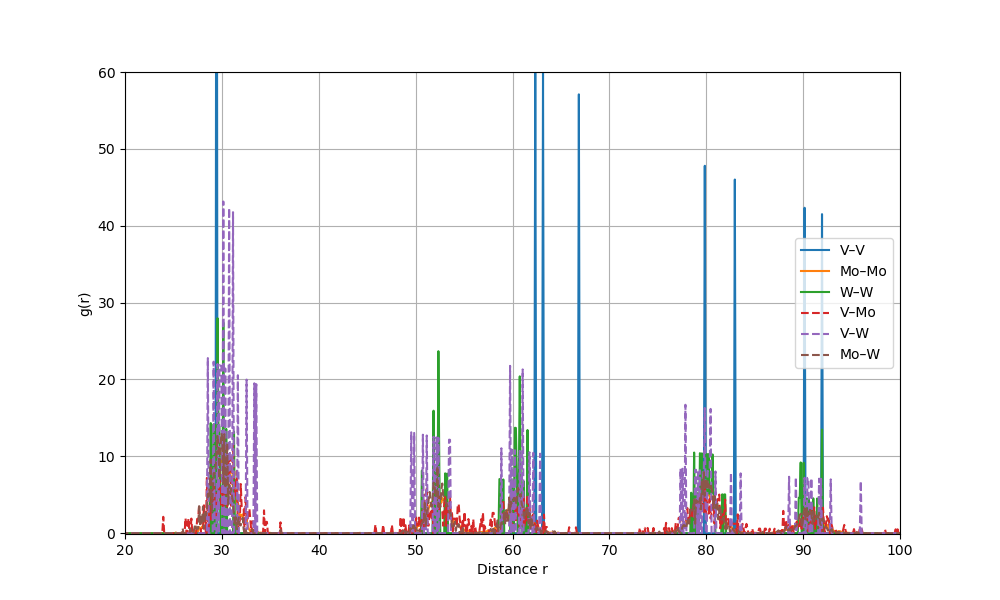

In [51]:
def compute_pdf(positions_A, positions_B, r_max, dr, area=None, density=None):
    distances = cdist(positions_A, positions_B)
    distances = distances.flatten()
    bins = np.arange(0, r_max + dr, dr)
    hist, edges = np.histogram(distances, bins=bins)
    r = 0.5 * (edges[:-1] + edges[1:])  # bin centers
    shell_area = np.pi * (edges[1:]**2 - edges[:-1]**2)  # area of each annulus
    if area is None:
        x_min = min(positions_A[:,0].min(), positions_B[:,0].min())
        x_max = max(positions_A[:,0].max(), positions_B[:,0].max())
        y_min = min(positions_A[:,1].min(), positions_B[:,1].min())
        y_max = max(positions_A[:,1].max(), positions_B[:,1].max())
        area = (x_max - x_min) * (y_max - y_min)
    if density is None:
        density = len(positions_B) / area
    expected = density * shell_area * len(positions_A)  # expected counts in random distribution
    g_r = hist / expected
    
    return r, g_r

r_max = 100
dr = 0.1

r_VV, g_VV = compute_pdf(V_pos, V_pos, r_max, dr)
r_MoMo, g_MoMo = compute_pdf(Mo_pos, Mo_pos, r_max, dr)
r_WW, g_WW = compute_pdf(W_pos, W_pos, r_max, dr)

r_VMo, g_VMo = compute_pdf(V_pos, Mo_pos, r_max, dr)
r_VW, g_VW = compute_pdf(V_pos, W_pos, r_max, dr)
r_MoW, g_MoW = compute_pdf(Mo_pos, W_pos, r_max, dr)

# Plot
plt.figure(figsize=(10, 6))
plt.plot(r_VV, g_VV, label='V-V')
plt.plot(r_MoMo, g_MoMo, label='Mo-Mo')
plt.plot(r_WW, g_WW, label='W-W')
plt.plot(r_VMo, g_VMo, label='V-Mo', linestyle='--')
plt.plot(r_VW, g_VW, label='V-W', linestyle='--')
plt.plot(r_MoW, g_MoW, label='Mo-W', linestyle='--')

plt.ylim(-0.1, 60)
plt.xlim(20,100)
plt.xlabel('Distance r')
plt.ylabel('g(r)')
plt.legend()
plt.grid(True)
plt.show()

### PCA based on atomistic descriptors

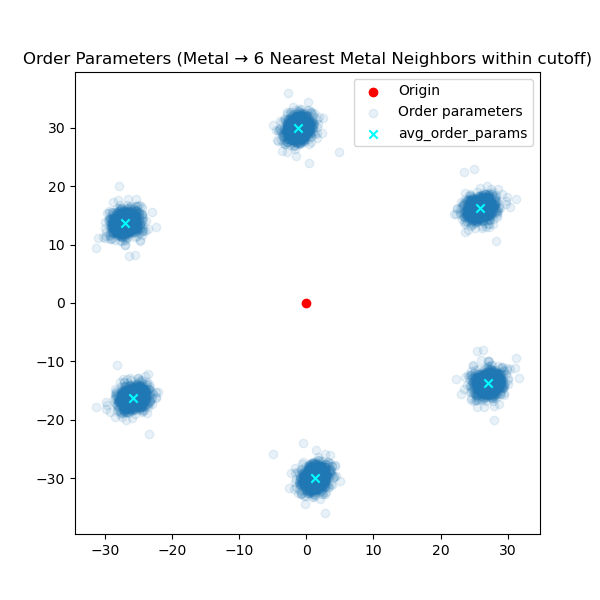

In [61]:
# generate cutoff
metal_tree = cKDTree(metal_pos)
dists_nn, _ = metal_tree.query(metal_pos, k=2)
avg_nn_distance = np.mean(dists_nn[:, 1])
cutoff = 1.5 * avg_nn_distance
dists, idxs = metal_tree.query(metal_pos, k=7)

all_order_params = []
valid_indices = []
for i, metal in enumerate(metal_pos):
    neighbor_mask = (dists[i][1:7] <= cutoff)
    if np.sum(neighbor_mask) < 6:
        continue
    
    neighbor_idxs = idxs[i][1:7][neighbor_mask]
    neighbor_vecs = metal_pos[neighbor_idxs] - metal
    
    # Sort by angle
    angles = np.arctan2(neighbor_vecs[:, 1], neighbor_vecs[:, 0])
    sorted_idx = np.argsort(angles)
    sorted_vecs = neighbor_vecs[sorted_idx]
    
    all_order_params.append(sorted_vecs)
    valid_indices.append(i)
all_order_params = np.array(all_order_params)  # shape (n_valid_atoms, 6, 2)

# get average via kmeans
order_params_2d = np.concatenate(all_order_params, axis=0)
order_params_flat = (order_params_2d).reshape(-1, 2)
kmeans = KMeans(n_clusters=6, random_state=0).fit(order_params_flat)
cluster_centers = kmeans.cluster_centers_ 
avg_order_params = cluster_centers.reshape(6, 2)

fig, ax = plt.subplots(figsize=(6,6))
ax.scatter(0, 0, label='Origin', c='r')
ax.scatter(order_params_2d[:, 0], order_params_2d[:, 1], alpha=0.1, label='Order parameters')
plt.scatter(avg_order_params[:, 0], avg_order_params[:, 1], c='cyan', label='avg_order_params', marker = 'x')
ax.set_title('Order Parameters (Metal → 6 Nearest Metal Neighbors within cutoff)')
ax.legend()

In [63]:
# Flatten for PCA: (n_samples, 12)
X = all_order_params.reshape(all_order_params.shape[0], -1)

# Initialize PCA with desired number of components
n_components = 8
pca = PCA(n_components=n_components)

# Fit PCA and transform data
X_pca = pca.fit_transform(X)


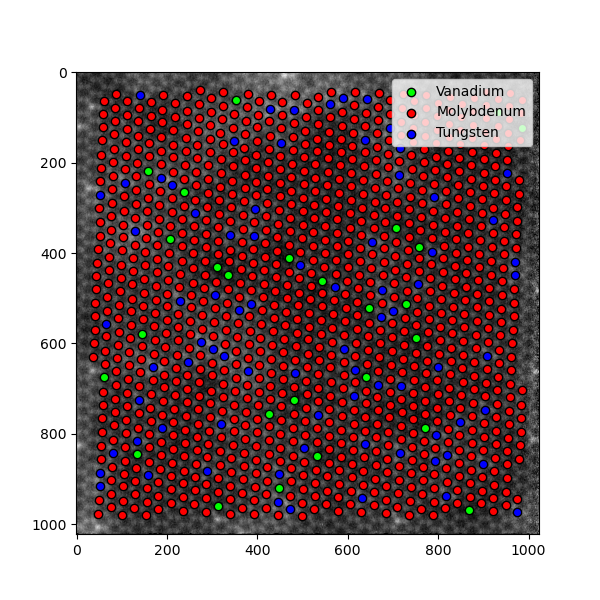

In [131]:
fig, ax = plt.subplots(1,1,figsize = (6,6))
colors = ['#FF0000', '#00FF00', '#0000FF'] 

ax.imshow(avg_im.T, cmap='grey',vmin=0.2,vmax=0.7)
ax.scatter(V_pos[:,0], V_pos[:,1], alpha=1, c=colors[1], edgecolors='k', label = 'Vanadium')
ax.scatter(Mo_pos[:,0], Mo_pos[:,1], alpha=1, c=colors[0], edgecolors='k', label = 'Molybdenum')
ax.scatter(W_pos[:,0], W_pos[:,1], alpha=1, c=colors[2], edgecolors='k', label = 'Tungsten')
ax.legend(loc='upper right')

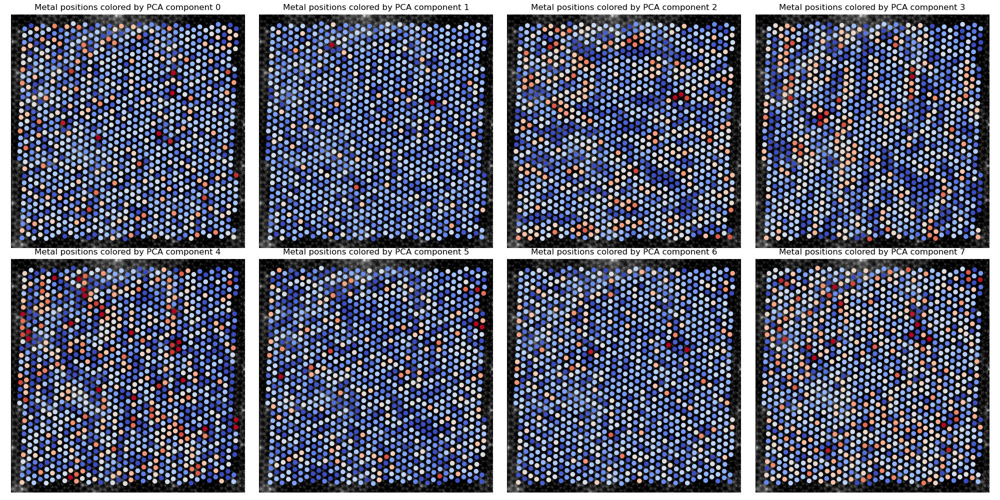

In [143]:
fig, ax = plt.subplots(2,4, sharex=True, sharey=True, figsize = (20,10))
ax =ax.ravel()

for i in range(n_components):

    vmin = np.min(X_pca[:, i]) * 0.3
    vmax = np.max(X_pca[:, i]) * 0.7

    ax[i].imshow(avg_im.T, cmap='grey',vmin=0.3,vmax=0.7)
    ax[i].scatter(metal_pos[valid_indices, 0], metal_pos[valid_indices, 1], c=X_pca[:, i], cmap='coolwarm',vmin=vmin, vmax=vmax)


    ax[i].set_title(f'Metal positions colored by PCA component {i}')
    ax[i].axis('off')

fig.tight_layout()

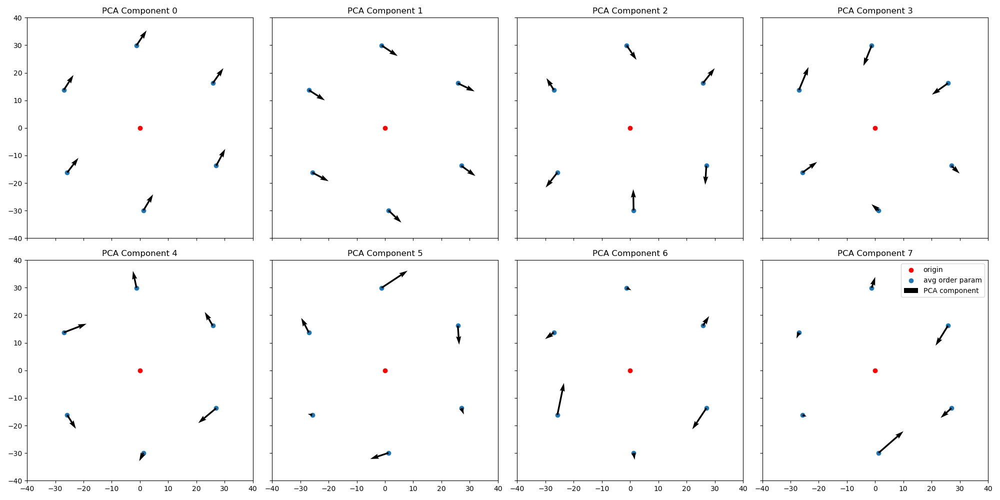

In [127]:
pca_vectors = pca.components_.reshape(n_components, 6, 2)  # shape: (5, 6, 2)

fig, ax = plt.subplots(2,4, sharex=True, sharey=True, figsize = (20,10))
ax =ax.ravel()

for i in range(n_components):
    ax[i].scatter(0, 0, color='red', label='origin')
    
    # Scatter average order parameters
    ax[i].scatter(avg_order_params[:, 0], avg_order_params[:, 1], label='avg order param')
    
    # Quiver: PCA component vectors starting from avg_order_params
    ax[i].quiver(avg_order_params[:, 0], avg_order_params[:, 1], pca_vectors[i, :, 0], pca_vectors[i, :, 1], label='PCA component', scale=5)
    
    ax[i].set_title(f"PCA Component {i}")
    ax[i].set_xlim(-40,40)
    ax[i].set_ylim(-40,40)


ax[7].legend()
fig.tight_layout()


In [128]:
# Select only valid atoms used in PCA
valid_intensities = metal_int_norm[valid_indices]
valid_positions = metal_pos[valid_indices]


cutoffs = [0.93, 1.11]

V_filter  = np.where(valid_intensities < cutoffs[0])[0]
Mo_filter = np.where((valid_intensities >= cutoffs[0]) & (valid_intensities <= cutoffs[1]))[0]
W_filter  = np.where(valid_intensities > cutoffs[1])[0]

# Get positions and PCA-transformed values for each
V_pos = valid_positions[V_filter]
Mo_pos = valid_positions[Mo_filter]
W_pos = valid_positions[W_filter]

X_pca_V  = X_pca[V_filter]
X_pca_Mo = X_pca[Mo_filter]
X_pca_W  = X_pca[W_filter]

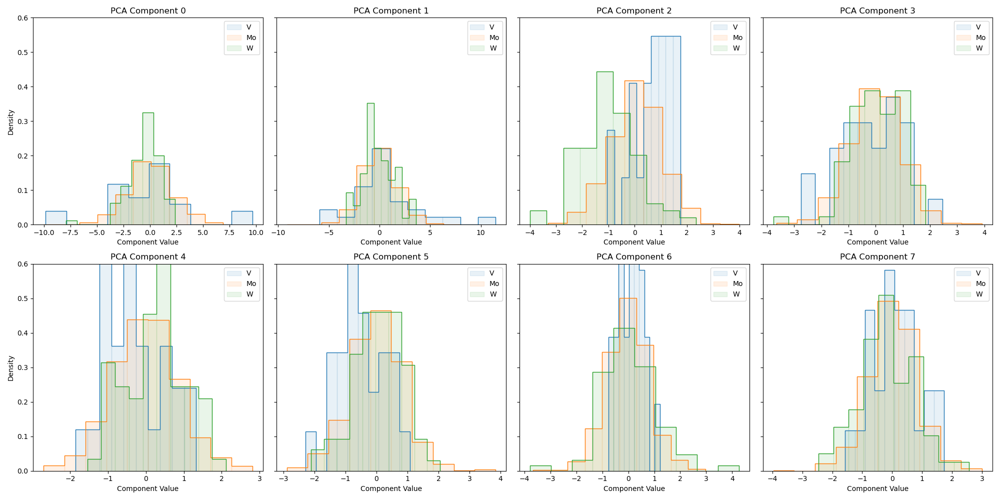

In [142]:
categories = ['V', 'Mo', 'W']
colors = ['tab:blue', 'tab:orange', 'tab:green']
X_pca_sets = [X_pca_V, X_pca_Mo, X_pca_W]

fig, ax = plt.subplots(2, 4, figsize=(20, 10), sharey=True)
ax = ax.ravel()

bins = 10  # Adjust number of histogram bins if needed

for i in range(n_components):
    for j, (label, X_cat, color) in enumerate(zip(categories, X_pca_sets, colors)):
        ax[i].hist(X_cat[:, i], bins=bins, alpha=0.1, label=label, color=color, density=True, edgecolor=color)
        ax[i].hist(X_cat[:, i], histtype='step', bins=bins, alpha=1, color=color, density=True, edgecolor=color)
    
    ax[i].set_title(f'PCA Component {i}')
    ax[i].set_xlabel('Component Value')
    if i % 4 == 0:
        ax[i].set_ylabel('Density')
    ax[i].legend()
    ax[i].set_ylim(0, 0.6)
fig.tight_layout()
plt.show()

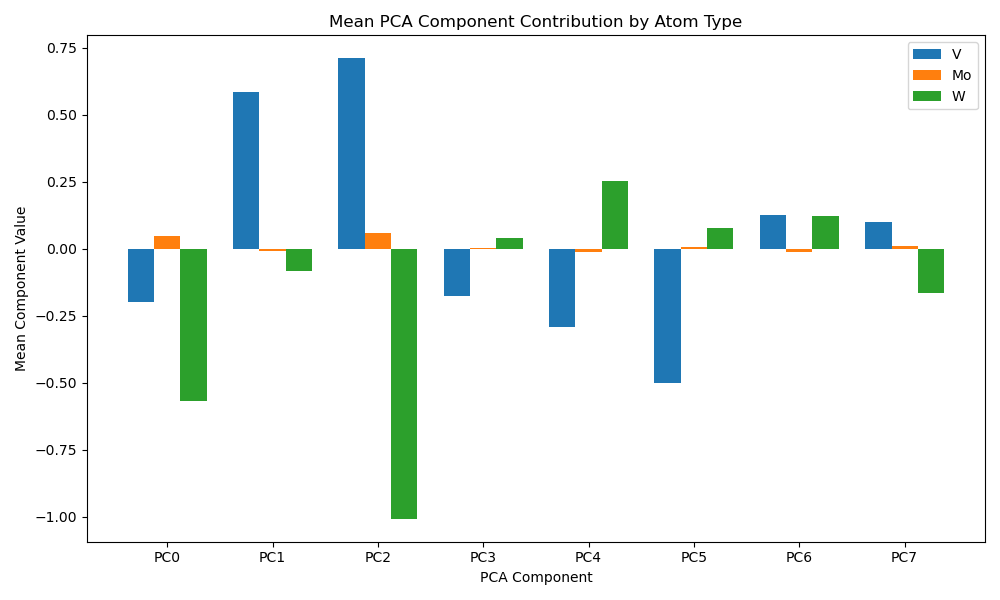

In [129]:

# Compute mean PCA values for each atom type
mean_V  = np.mean(X_pca_V, axis=0)  # shape (n_components,)
mean_Mo = np.mean(X_pca_Mo, axis=0)
mean_W  = np.mean(X_pca_W, axis=0)

# Stack into an array for plotting
means = np.vstack([mean_V, mean_Mo, mean_W])  # shape (3, n_components)
categories = ['V', 'Mo', 'W']
n_components = means.shape[1]

# Plot
x = np.arange(n_components)
bar_width = 0.25

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(x - bar_width, means[0], width=bar_width, label='V')
ax.bar(x,             means[1], width=bar_width, label='Mo')
ax.bar(x + bar_width, means[2], width=bar_width, label='W')

ax.set_xlabel('PCA Component')
ax.set_ylabel('Mean Component Value')
ax.set_title('Mean PCA Component Contribution by Atom Type')
ax.set_xticks(x)
ax.set_xticklabels([f'PC{i}' for i in range(n_components)])
ax.legend()

plt.tight_layout()
plt.show()

In [ ]:
image.x.values[1] * np.linalg.norm(pca_vectors[2],axis=1) * 1000